# Task 1: Filters Visualization
## 1.1 - Load VGG16
We are loading a (pretrained) VGG16 via torchvision

In [1]:
import numpy as np
import os
import torch
from torch.optim import Adam
from torchvision import models
from filters_visualization import visualise_layer_filter, visualise_layer_filter_2, visualise_layer_filter_2_start, visualise_layer_filter_1_5, total_variation_loss
from aux_ops import preprocess_image, recreate_image, save_image
import matplotlib.pyplot as plt

# Select the device to work on.
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

model = models.vgg16(weights='DEFAULT')
print(model)


c:\Users\Ilir\anaconda3\envs\gen-ai\Lib\site-packages\torchvision\io\image.py:13: UserWarning: Failed to load image Python extension: '[WinError 127] Die angegebene Prozedur wurde nicht gefunden'If you don't plan on using image functionality from `torchvision.io`, you can ignore this warning. Otherwise, there might be something wrong with your environment. Did you have `libjpeg` or `libpng` installed before building `torchvision` from source?
  warn(


device:  cuda:0
Using: cuda:0
VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, s

## 1.2 - Optimize input image


c:\Users\Ilir\Desktop\LMU\SS24\Gen AI\generative-ai-image-synthesis\exercise_5\filters_visualization.py:36: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  processed_image = torch.tensor(processed_image, device=device).float()


Layer 0:
  Shape: torch.Size([1, 64, 224, 224])
  Mean: -0.0700
  Min: -3.6053
  Max: 4.7991
Layer 1:
  Shape: torch.Size([1, 64, 224, 224])
  Mean: 0.2661
  Min: 0.0000
  Max: 4.7991
Layer 2:
  Shape: torch.Size([1, 64, 224, 224])
  Mean: -0.2675
  Min: -13.0603
  Max: 14.7440
Layer 3:
  Shape: torch.Size([1, 64, 224, 224])
  Mean: 0.5681
  Min: 0.0000
  Max: 14.7440
Layer 4:
  Shape: torch.Size([1, 64, 112, 112])
  Mean: 1.2875
  Min: 0.0000
  Max: 14.7440
Layer 5:
  Shape: torch.Size([1, 128, 112, 112])
  Mean: -1.7256
  Min: -26.6329
  Max: 17.7948
Layer 6:
  Shape: torch.Size([1, 128, 112, 112])
  Mean: 0.7655
  Min: 0.0000
  Max: 17.7948
Layer 7:
  Shape: torch.Size([1, 128, 112, 112])
  Mean: -1.7290
  Min: -30.6048
  Max: 31.9851
Layer 8:
  Shape: torch.Size([1, 128, 112, 112])
  Mean: 0.9272
  Min: 0.0000
  Max: 31.9851
Layer 9:
  Shape: torch.Size([1, 128, 56, 56])
  Mean: 2.0084
  Min: 0.0000
  Max: 31.9851
Layer 10:
  Shape: torch.Size([1, 256, 56, 56])
  Mean: -1.9303
  Mi

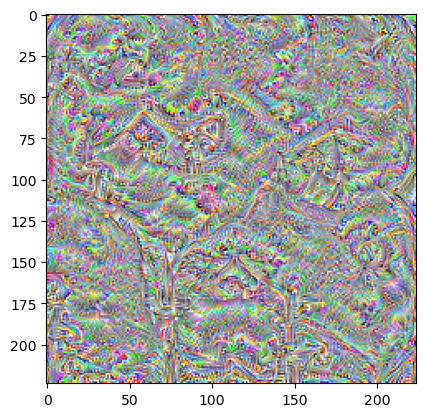

In [2]:
# TODO: add your code here
model.eval()
layer_nmbr = 28
filter_nmbr = 228

# Fix model weights
for param in model.parameters():
    param.requires_grad = False

model.to(device)
optimized_image = visualise_layer_filter(model.features, layer_nmbr=layer_nmbr, filter_nmbr=filter_nmbr, print_statistics=True)

plt.imshow(optimized_image)
plt.show()


## Task 1.3 - Visualize a random filter.

c:\Users\Ilir\Desktop\LMU\SS24\Gen AI\generative-ai-image-synthesis\exercise_5\filters_visualization.py:36: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  processed_image = torch.tensor(processed_image, device=device).float()


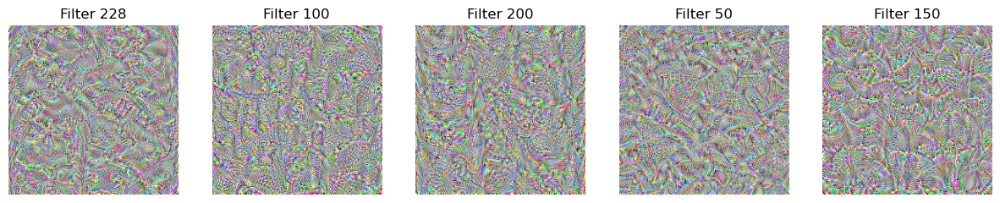

In [13]:
# TODO: add your code here
filter_nmbrs = [228, 100, 200, 50, 150]  # Random filters for visualization
layer_nmbr = 28
# Create a figure for plotting
plt.figure(figsize=(15, 10))
for i,filter_nmbr in enumerate(filter_nmbrs):
    optimized_image = visualise_layer_filter(model.features, layer_nmbr=layer_nmbr, filter_nmbr=filter_nmbr)

    # Display the optimized image
    plt.subplot(1, len(filter_nmbrs), i + 1)
    plt.title(f'Filter {filter_nmbr}')
    plt.imshow(optimized_image)
    plt.axis('off')
plt.show()

## Task 1.4 - Visualize filters at different layers.

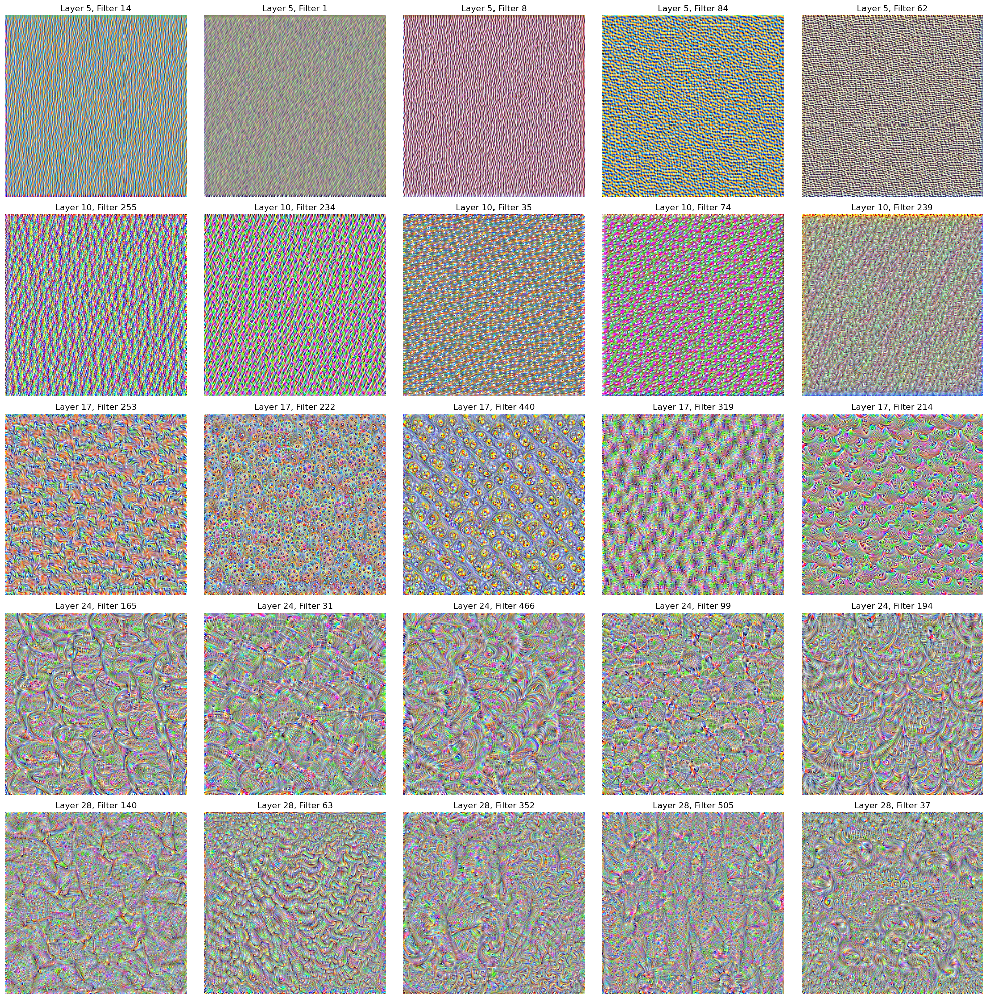

In [4]:
# TODO: add your code here
layer_nmbers = [5, 10, 17, 24, 28]  # Different layers for visualization

# Visualize each filter at each layer
fig, axs = plt.subplots(len(layer_nmbers), 5, figsize=(20, 20))
for i, layer_nmbr in enumerate(layer_nmbers):
    # Get the number of filters in the current layer
    num_filters = model.features[layer_nmbr].out_channels
    # Choose 5 random filter within the valid range of the layer
    filter_nmbrs = np.random.choice(num_filters, size=5, replace=False)
    for j, filter_nmbr in enumerate(filter_nmbrs):
        optimized_image = visualise_layer_filter(model.features, layer_nmbr=layer_nmbr, filter_nmbr=filter_nmbr)

        # Display the optimized image
        axs[i, j].imshow(optimized_image)
        axs[i, j].set_title(f'Layer {layer_nmbr}, Filter {filter_nmbr}')
        axs[i, j].axis('off')

plt.tight_layout()
plt.show()

Going from earlier layers to later layers we can observe complex structures forming and not only lines or edges being detected but more complex forms.
Filters in earlier layers may capture basic features like edges and textures, while filters in later layers capture more complex patterns

## Task 1.5 - Hyperparameter tuning.


c:\Users\Ilir\Desktop\LMU\SS24\Gen AI\generative-ai-image-synthesis\exercise_5\filters_visualization.py:94: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  processed_image = torch.tensor(processed_image, device=device).float()


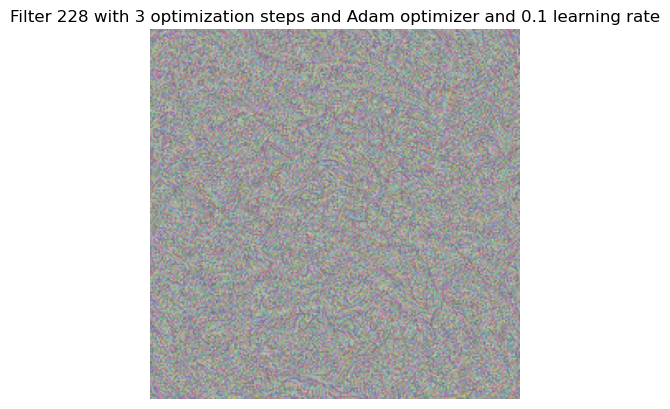

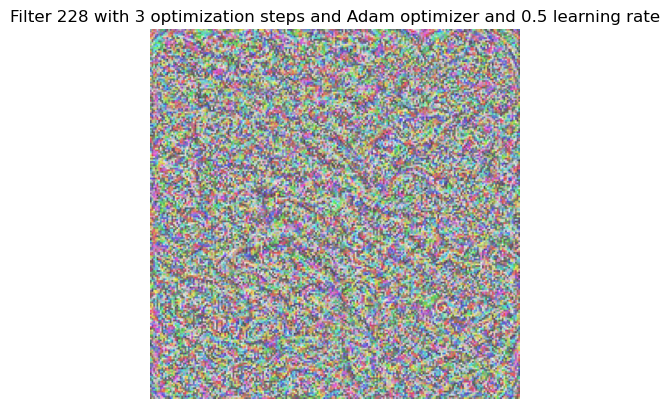

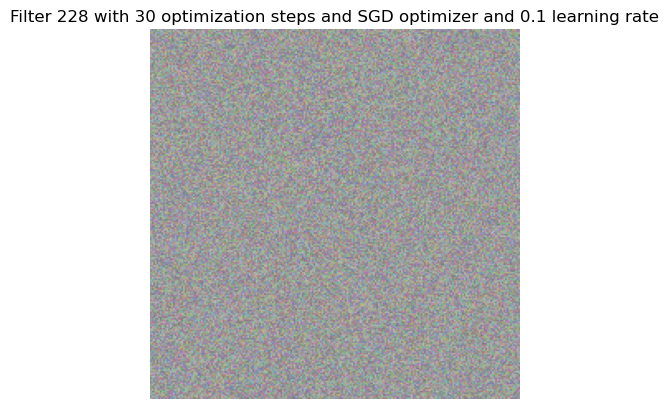

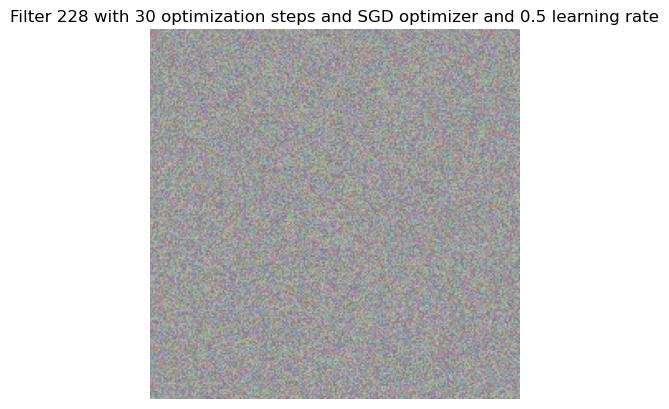

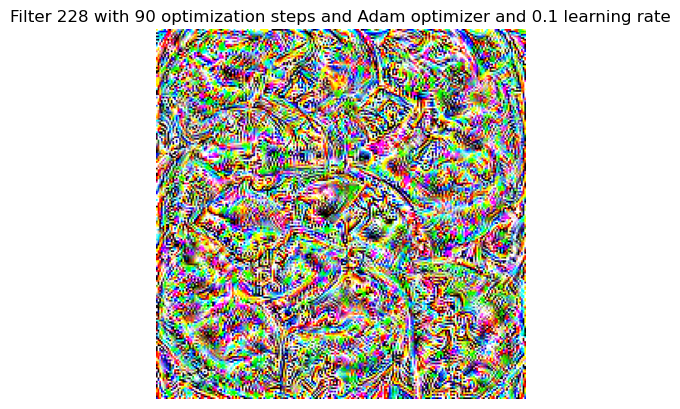

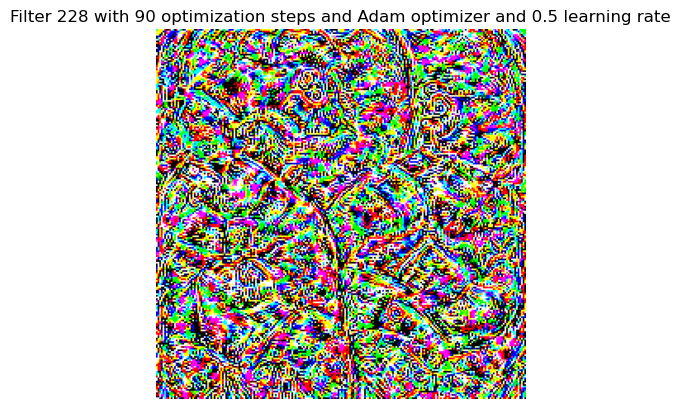

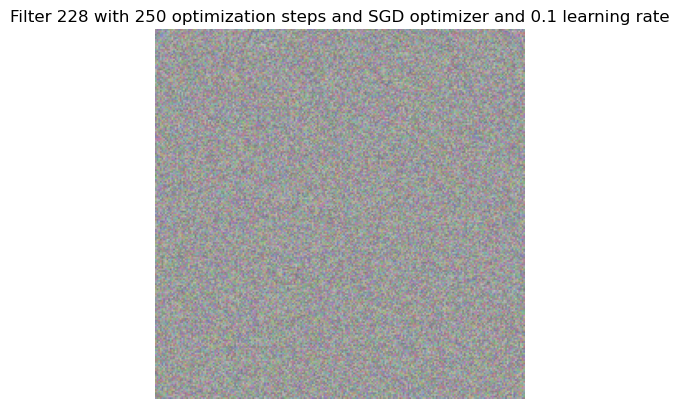

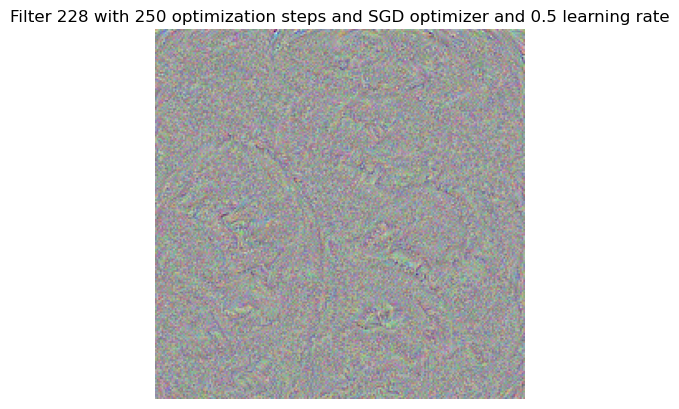

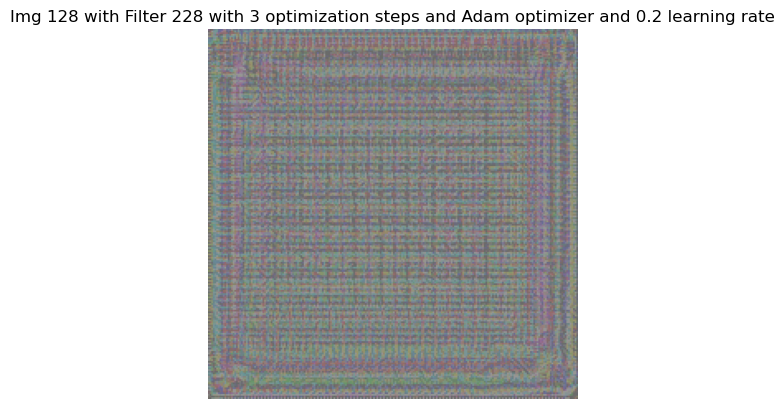

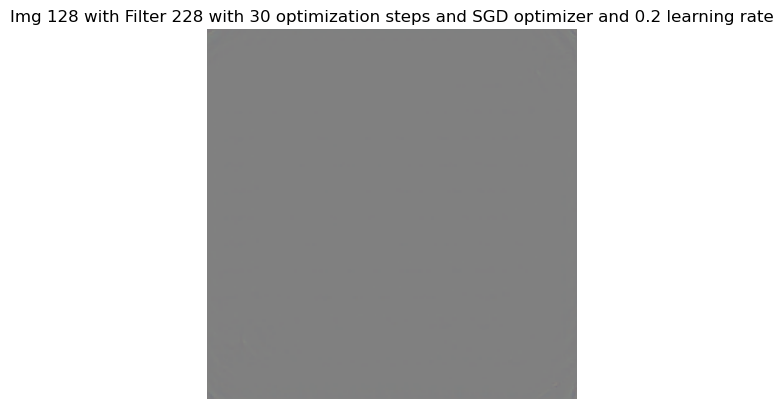

In [5]:
# TODO: add your code here
layer_nmbr = 28
filter_nmbr = 228
optim_steps = 3
optimizer = 'Adam'
lr=0.1
optimized_image = visualise_layer_filter_1_5(model.features, layer_nmbr=layer_nmbr, filter_nmbr=filter_nmbr, num_optim_steps=optim_steps, lr=lr, optimizer=optimizer)

# Display the optimized image
plt.figure()
plt.title(f'Filter {filter_nmbr} with {optim_steps} optimization steps and {optimizer} optimizer and {lr} learning rate')
plt.imshow(optimized_image)
plt.axis('off')
plt.show()

layer_nmbr = 28
filter_nmbr = 228
optim_steps = 3
optimizer = 'Adam'
lr=0.5
optimized_image = visualise_layer_filter_1_5(model.features, layer_nmbr=layer_nmbr, filter_nmbr=filter_nmbr, num_optim_steps=optim_steps, lr=lr, optimizer=optimizer)

# Display the optimized image
plt.figure()
plt.title(f'Filter {filter_nmbr} with {optim_steps} optimization steps and {optimizer} optimizer and {lr} learning rate')
plt.imshow(optimized_image)
plt.axis('off')
plt.show()

# TODO: add your code here
layer_nmbr = 28
filter_nmbr = 228
optim_steps = 30
optimizer = 'SGD'
lr=0.1
optimized_image = visualise_layer_filter_1_5(model.features, layer_nmbr=layer_nmbr, filter_nmbr=filter_nmbr, num_optim_steps=optim_steps, lr=lr, optimizer=optimizer)

# Display the optimized image
plt.figure()
plt.title(f'Filter {filter_nmbr} with {optim_steps} optimization steps and {optimizer} optimizer and {lr} learning rate')
plt.imshow(optimized_image)
plt.axis('off')
plt.show()

layer_nmbr = 28
filter_nmbr = 228
optim_steps = 30
optimizer = 'SGD'
lr=0.5
optimized_image = visualise_layer_filter_1_5(model.features, layer_nmbr=layer_nmbr, filter_nmbr=filter_nmbr, num_optim_steps=optim_steps, lr=lr, optimizer=optimizer)

# Display the optimized image
plt.figure()
plt.title(f'Filter {filter_nmbr} with {optim_steps} optimization steps and {optimizer} optimizer and {lr} learning rate')
plt.imshow(optimized_image)
plt.axis('off')
plt.show()

layer_nmbr = 28
filter_nmbr = 228
optim_steps = 90
optimizer = 'Adam'
lr=0.1
optimized_image = visualise_layer_filter_1_5(model.features, layer_nmbr=layer_nmbr, filter_nmbr=filter_nmbr, num_optim_steps=optim_steps, lr=lr, optimizer=optimizer)

# Display the optimized image
plt.figure()
plt.title(f'Filter {filter_nmbr} with {optim_steps} optimization steps and {optimizer} optimizer and {lr} learning rate')
plt.imshow(optimized_image)
plt.axis('off')
plt.show()

layer_nmbr = 28
filter_nmbr = 228
optim_steps = 90
optimizer = 'Adam'
lr=0.5
optimized_image = visualise_layer_filter_1_5(model.features, layer_nmbr=layer_nmbr, filter_nmbr=filter_nmbr, num_optim_steps=optim_steps, lr=lr, optimizer=optimizer)

# Display the optimized image
plt.figure()
plt.title(f'Filter {filter_nmbr} with {optim_steps} optimization steps and {optimizer} optimizer and {lr} learning rate')
plt.imshow(optimized_image)
plt.axis('off')
plt.show()

layer_nmbr = 28
filter_nmbr = 228
optim_steps = 250
optimizer = 'SGD'
lr=0.1
optimized_image = visualise_layer_filter_1_5(model.features, layer_nmbr=layer_nmbr, filter_nmbr=filter_nmbr, num_optim_steps=optim_steps, lr=lr, optimizer=optimizer)

# Display the optimized image
plt.figure()
plt.title(f'Filter {filter_nmbr} with {optim_steps} optimization steps and {optimizer} optimizer and {lr} learning rate')
plt.imshow(optimized_image)
plt.axis('off')
plt.show()

layer_nmbr = 28
filter_nmbr = 228
optim_steps = 250
optimizer = 'SGD'
lr=0.5
optimized_image = visualise_layer_filter_1_5(model.features, layer_nmbr=layer_nmbr, filter_nmbr=filter_nmbr, num_optim_steps=optim_steps, lr=lr, optimizer=optimizer)

# Display the optimized image
plt.figure()
plt.title(f'Filter {filter_nmbr} with {optim_steps} optimization steps and {optimizer} optimizer and {lr} learning rate')
plt.imshow(optimized_image)
plt.axis('off')
plt.show()

#from now on with the image with 128
layer_nmbr = 28
filter_nmbr = 228
optim_steps = 3
optimizer = 'Adam'
lr=0.2
optimized_image = visualise_layer_filter_1_5(model.features, layer_nmbr=layer_nmbr, filter_nmbr=filter_nmbr, num_optim_steps=optim_steps, lr=lr, optimizer=optimizer,new_img=True)

# Display the optimized image
plt.figure()
plt.title(f'Img 128 with Filter {filter_nmbr} with {optim_steps} optimization steps and {optimizer} optimizer and {lr} learning rate')
plt.imshow(optimized_image)
plt.axis('off')
plt.show()

# TODO: add your code here
layer_nmbr = 28
filter_nmbr = 228
optim_steps = 30
optimizer = 'SGD'
lr=0.2
optimized_image = visualise_layer_filter_1_5(model.features, layer_nmbr=layer_nmbr, filter_nmbr=filter_nmbr, num_optim_steps=optim_steps, lr=lr, optimizer=optimizer,new_img=True)

# Display the optimized image
plt.figure()
plt.title(f'Img 128 with Filter {filter_nmbr} with {optim_steps} optimization steps and {optimizer} optimizer and {lr} learning rate')
plt.imshow(optimized_image)
plt.axis('off')
plt.show()



Increasing the number of optimizations steps improves the feature representation and higher complexity. But a too large number causes the filters activation to overfit and the image becomes overly specific.
With a higher learning rate we can alter the image faster to maximize the filter activations. But increasing it too much causes overshooting or increased noise in the image.
Adam converges faster, SGD is slow in convergance. SGD is also overly sensitive to the LR whereas Adam adapts it. Adam handles the complex structures in the images better.

## Task 1.6 - Pretrained weights.


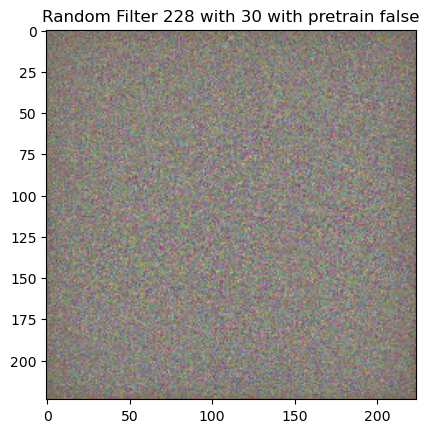

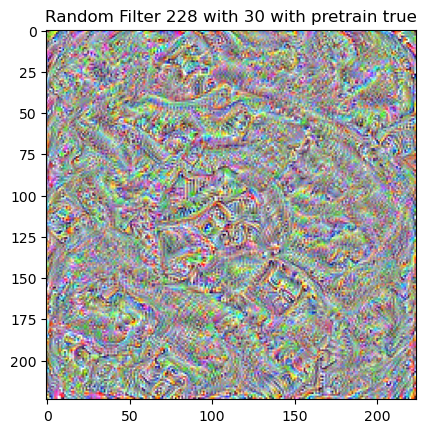

In [11]:
# TODO: add your code here
# NO WEIGHTS
model = models.vgg16() # no weights pretrained
model.to(device)
model.eval()
layer_nmbr = 28
filter_nmbr = 228

for param in model.parameters():
    param.requires_grad = False

model.cuda()
optimized_image = visualise_layer_filter(model.features, layer_nmbr=layer_nmbr, filter_nmbr=filter_nmbr)

plt.title(f'Random Filter {filter_nmbr} with {optim_steps} with pretrain false')
plt.imshow(optimized_image)
plt.show()

#PRETRAINED WEIGHTS
model = models.vgg16(weights='DEFAULT') # pretrained weights
model.to(device)
model.eval()
layer_nmbr = 28
filter_nmbr = 228

# Fix model weights
for param in model.parameters():
    param.requires_grad = False

model.cuda()
optimized_image = visualise_layer_filter(model.features, layer_nmbr=layer_nmbr, filter_nmbr=filter_nmbr)

plt.title(f'Random Filter {filter_nmbr} with {optim_steps} with pretrain true')
plt.imshow(optimized_image)
plt.show()

With pretrained weights the visualisations have structure and may have patterns that make sense, because the filters have been trained on datasets and have learned them.
Without pretrained weights the visualisations will be random or without structure. They can't recognize any features and might show only high noise.

# Task 2: Deep Dream

## Task 1.1 Most activated filters for every image

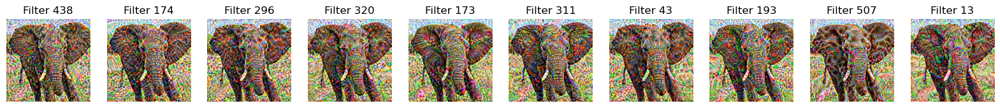

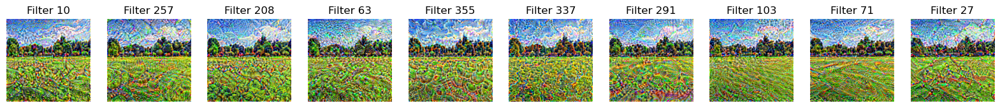

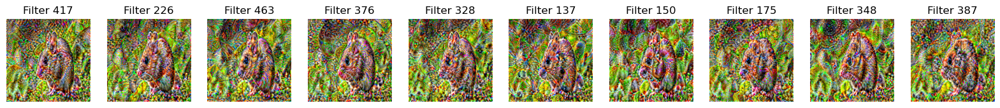

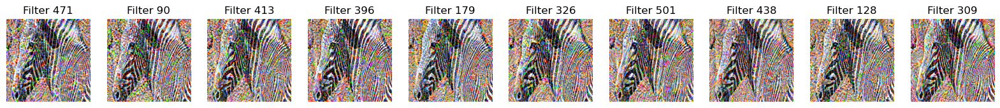

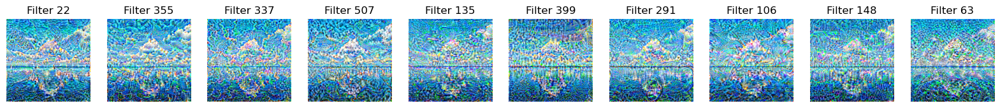

In [8]:
# TODO: add your code here
from PIL import Image

layer_nmbr = 30  # Example layer
image_paths = ["images/elephant.jpg", "images/field.jpg", "images/mouse.jpg", "images/zebra.jpg", "images/sky-water.jpg"]

model = models.vgg16(weights='DEFAULT').features.to(device)
model.eval()

for param in model.parameters():
    param.requires_grad = False

for img_path in image_paths:
    img = Image.open(img_path)
    img = np.array(img)
    img_tensor = preprocess_image(img)
    img_tensor = img_tensor.to(device)
    x = img_tensor
    for index, layer in enumerate(model):
        x = layer(x)
        if index == layer_nmbr:
            break

    conv_output = x[0] # all filters of the conv output

    # Find the 10 most activated filters
    mean_activations = torch.mean(conv_output, dim=[1, 2])
    top_10_filters = torch.argsort(mean_activations, descending=True)[:10]

    # Collect optimized images
    optimized_images = []
    for filter_nmbr in top_10_filters:
        optimized_image = visualise_layer_filter_2_start(model,layer_nmbr=layer_nmbr,filter_nmbr=filter_nmbr.item(),init_img=img_tensor,num_optim_steps=50)
        optimized_images.append(optimized_image)

    # Plot the optimized images together
    fig, axs = plt.subplots(1, 10, figsize=(20, 2))
    for ax, img, filter_nmbr in zip(axs, optimized_images, top_10_filters):
        ax.imshow(img)
        ax.set_title(f"Filter {filter_nmbr.item()}")
        ax.axis('off')
    plt.show()
    

Different images activate different filters. The eyes on the elephant activate filters that have learned to detect eyes.
In the picture with the green field we can see different forms forming on the grass (can't explain what these forms are).
The content of the images influences which filters are most activated. Images with a lot of edges might activate filters specialized in edge detection.

## Task 1.2 Total variation loss.

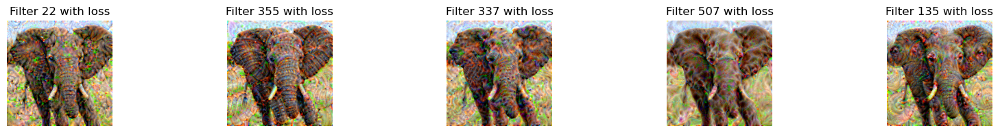

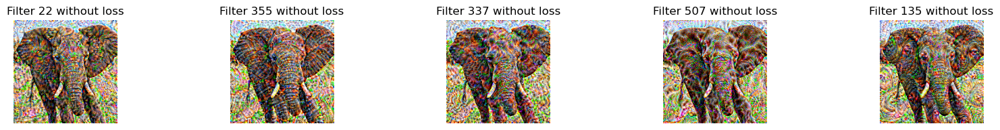

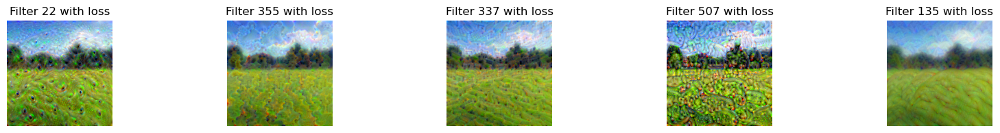

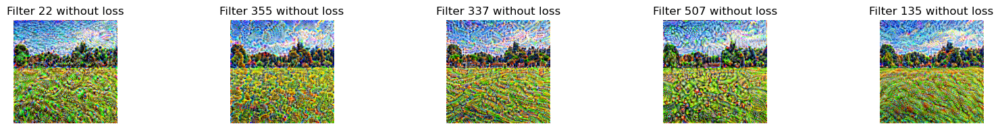

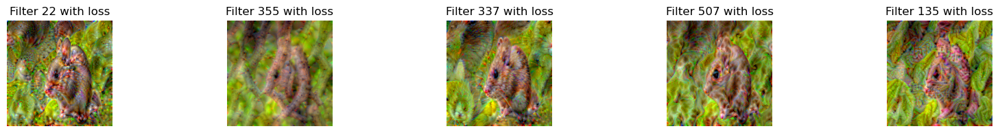

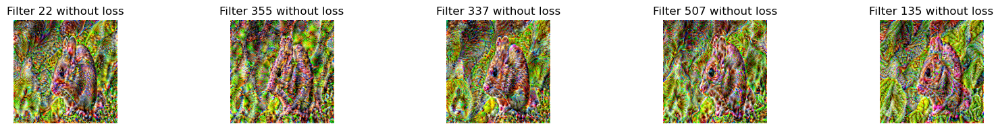

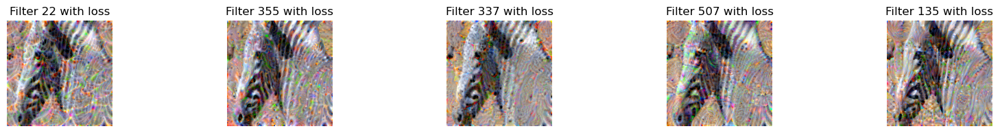

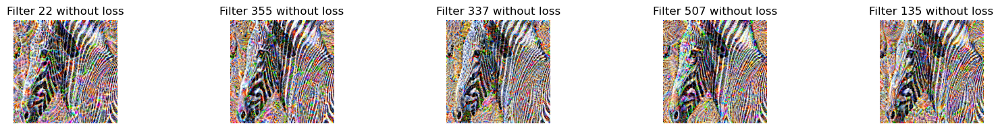

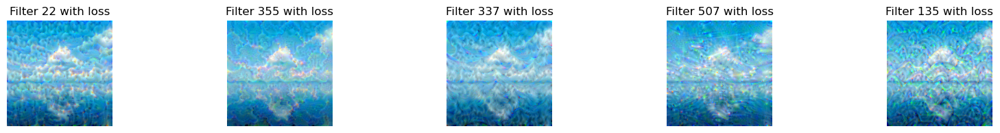

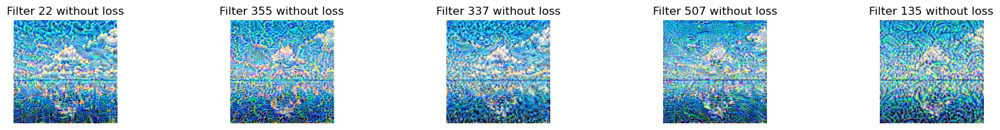

In [14]:
# TODO: add your code here
model = models.vgg16(weights='DEFAULT').features.to(device)
model.eval()

for param in model.parameters():
    param.requires_grad = False

for img_path in image_paths:
    img = Image.open(img_path)
    img = np.array(img)
    img_tensor = preprocess_image(img)
    img_tensor = img_tensor.to(device)
    x = img_tensor
    for index, layer in enumerate(model):
        x = layer(x)
        if index == layer_nmbr:
            break

    conv_output = x[0]# all filters

    # Find the 10 most activated filters
    mean_activations = torch.mean(conv_output, dim=[1, 2])
    top_5_filters = torch.argsort(mean_activations, descending=True)[:5]

    # Collect optimized images
    optimized_images = []
    for filter_nmbr in top_5_filters:
        optimized_image = visualise_layer_filter_2(model,layer_nmbr=layer_nmbr,filter_nmbr=filter_nmbr.item(),init_img=img_tensor,num_optim_steps=50,tv_weight=0.5)
        optimized_images.append(optimized_image)

    # Plot the optimized images together
    fig, axs = plt.subplots(1, 5, figsize=(20, 2))
    for ax, img, filter_nmbr in zip(axs, optimized_images, top_10_filters):
        ax.imshow(img)
        ax.set_title(f"Filter {filter_nmbr.item()} with loss")
        ax.axis('off')
    plt.show()

    optimized_images = []
    for filter_nmbr in top_5_filters:
        optimized_image = visualise_layer_filter_2(model,layer_nmbr=layer_nmbr,filter_nmbr=filter_nmbr.item(),init_img=img_tensor,num_optim_steps=50,tv_weight=0)
        optimized_images.append(optimized_image)

    # Plot the optimized images together
    fig, axs = plt.subplots(1, 5, figsize=(20, 2))
    for ax, img, filter_nmbr in zip(axs, optimized_images, top_10_filters):
        ax.imshow(img)
        ax.set_title(f"Filter {filter_nmbr.item()} without loss")
        ax.axis('off')

    plt.show()

The weight of 0.5 penalises the edges in the image and makes it smoother. The lower the loss the less you penalise the edges and the more you see edges.

## Task 1.3 Deep dream.

In [39]:
import torch
import torch.optim as optim

def make_step(input_tensor, layer_numbers,optimizer,num_optim_steps, lr):

    input_tensor.requires_grad = True
    
    if optimizer == 'Adam':
        optimizer = optim.Adam([input_tensor], lr=lr) #specified what to update -> input image

    if optimizer =='SGD':
        optimizer = optim.SGD([input_tensor], lr=lr)

    # Optimization loop
    tv_weight = 1e-5

    for s in range(num_optim_steps):
        optimizer.zero_grad()
        x = input_tensor

        # Forward pass through all specified layers
        total_activation = 0
        for i, layer in enumerate(model):
            x = layer(x)
            if i in layer_numbers:
                total_activation += torch.norm(x) # using L2 norm

        # Define the loss as negative mean activation of all specified layers plus total variation loss
        activation_loss = total_activation
        tv_loss = total_variation_loss(input_tensor, tv_weight)
        total_loss = (-activation_loss) + tv_loss

        # Backward pass
        total_loss.backward()

        # Update the input image
        optimizer.step()
    
    return input_tensor

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


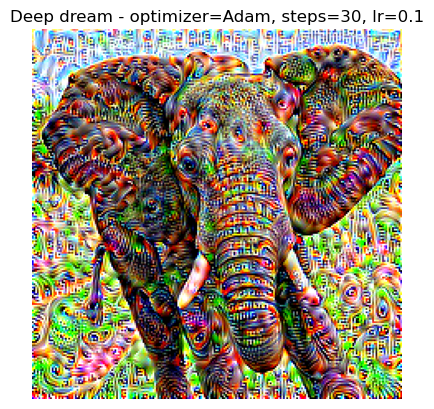

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


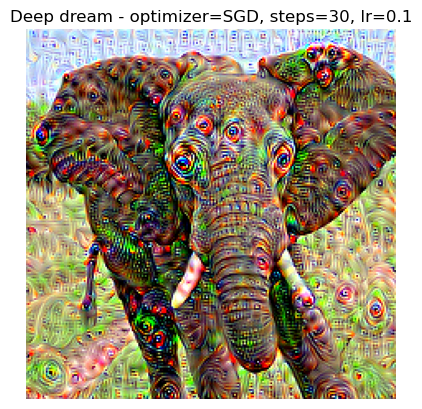

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


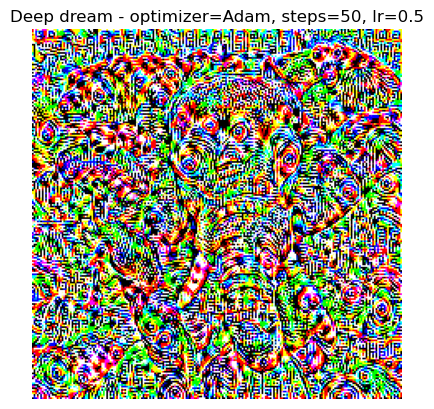

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


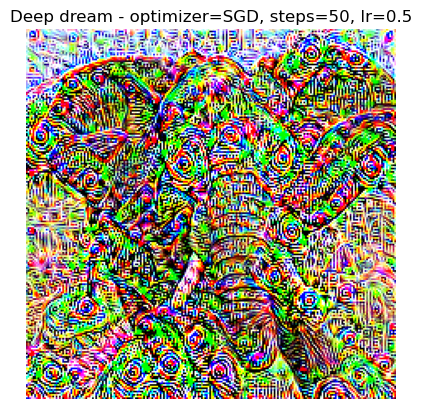

In [41]:
from torchvision import models, transforms
from PIL import Image

# Define image transformation
preprocess = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]), #using mean and std of ImageNet, it is apparently a standard way
])

#helper function
def load_image(image_path):
    image = Image.open(image_path)
    image_tensor = preprocess(image).unsqueeze(0)
    return image_tensor

#helper function
def recreate_image(tensor_img):
    recreated_numpy_img = tensor_img.clone().detach()
    recreated_numpy_img = recreated_numpy_img.squeeze(0)
    recreated_numpy_img = recreated_numpy_img.permute(1, 2, 0)
    recreated_numpy_img = recreated_numpy_img.numpy()
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    recreated_numpy_img = std * recreated_numpy_img + mean #normalize
    return recreated_numpy_img

# Initialize model
model = models.vgg16(weights='DEFAULT').features
model.eval()
model.to(device)

# Load and preprocess the input image
input_tensor = load_image('images/elephant.jpg').to(device)

layer_numbers = [3, 8, 15, 22, 29] # Layers: conv1_2, conv2_2, conv3_3, conv4_3, conv5_3

optimi='Adam'
steps = 30
lr=0.1
output_tensor = make_step(input_tensor,layer_numbers,optimi,steps,lr)

deep_dream_image = recreate_image(output_tensor.cpu())
plt.imshow(deep_dream_image)
plt.title(f'Deep dream - optimizer={optimi}, steps={steps}, lr={lr}')
plt.axis('off')
plt.show()

input_tensor = load_image('images/elephant.jpg').to(device)
optimi='SGD'
steps = 30
lr=0.1
output_tensor = make_step(input_tensor,layer_numbers,optimi,steps,lr)

deep_dream_image = recreate_image(output_tensor.cpu())
plt.imshow(deep_dream_image)
plt.title(f'Deep dream - optimizer={optimi}, steps={steps}, lr={lr}')
plt.axis('off')
plt.show()


optimi='Adam'
steps = 50
lr=0.5
output_tensor = make_step(input_tensor,layer_numbers,optimi,steps,lr)

deep_dream_image = recreate_image(output_tensor.cpu())
plt.imshow(deep_dream_image)
plt.title(f'Deep dream - optimizer={optimi}, steps={steps}, lr={lr}')
plt.axis('off')
plt.show()

input_tensor = load_image('images/elephant.jpg').to(device)
optimi='SGD'
steps = 50
lr=0.5
output_tensor = make_step(input_tensor,layer_numbers,optimi,steps,lr)

deep_dream_image = recreate_image(output_tensor.cpu())
plt.imshow(deep_dream_image)
plt.title(f'Deep dream - optimizer={optimi}, steps={steps}, lr={lr}')
plt.axis('off')
plt.show()


I think that the best result comes with the first image (lr=0.1, steps=30 and Adam). Other images dont have a lot of activations of the eyes or some are overfitting and damaging the original structure of the image (like the last 2 images). The second image is okay too, but we see that outside the elephant the eyes (activation) don't appear a lot.